# **POESPIN -- EXPERIMENT NOTEBOOK RECORD**  
"HOW CAN WE KNOW THE DANCER FROM THE DANCE?"- Yeatz (1865-1939)  

Cory Yihua Li(Director,AI Writting System,CGI) & Wendy Li(Director, Poet on the pole, Choreographer,CGI)  
Jiayi Li(Animator, Rigging, Cloth Design)  
Archy Hongyue Cheng(English Literature&Poetry Consultant)  

Mentor: Prof. Allison Parrish


Poespin实验过程记录： 
本笔记本记录了整个项目数据处理的思路和尝试，主要内容如下：  
1.初步构思  
2.Corpus的构建  
3.数据策略  
4.结果比较   
5.结语   


## **1.初步构思**  
受Martha Graham现代舞蹈之母:‘DANCE IS THE HIDDEN LANGUAGE OF THE SOUL’.的影响和启发,我们提出了一个问题：”如何将舞蹈转换为诗歌呢“舞蹈可能代表了人类最原始、最直接的表达方式。它不仅是一种艺术形式，更是一种根植于我们生物本能的交流方式。本项目旨在通过一个特定舞种‘钢管舞’作为舞蹈转译诗歌的初步尝试，我们在NYU Motion Capture 实验室采集了钢管舞舞者Wendy Li的钢管舞动捕数据并结合舞蹈语义与文化背景进行数据处理，旨在探索人的行为动作与计算语义空间的联系并创造设计舞蹈书写系统（Dance to Poetry AI Art System）。 
通过观察法，我们发现钢管舞舞蹈动作以圆周运动为主，舞者以身体核心力量与肢体舒展收缩展示舞姿，并有攀爬倒挂等表现形式，舞蹈动作有特有并极具创意的名称:Flamingo,Full Moon, Phonix...（https://www.onlinepolestudio.com/moves/pole/alphabetical/ ）基于这些空间与文化语义特点我们初步构建了三个思路:  
### 1.AI Agent as choreographer and 连环诗诗人
Based on rotation angle=>AI Agent(Vision API,BLIP Vision Recognition to identify what's the name of this movement)=>Imagine dancer's intention → Form 2D circular poetry pattern)=> One line for each tracker 

### 2.降维空间
TSNE/PCA dimensionality reduction and word distribution <br> Local similarity, overall corpus structure=>Tracker records <br> Write what kind of stuff 

### 3.动捕数据升维
 Based on high-dimensional spatial perspective (word vector dimensionality increase)=> Motion capture of four points: 3D → 300 D=> Read at high speed to extract points, then correspond to certain words=> Sentence fragments |



| Experimental Approach | AI Agent (Choreographer) | Process | Output |
|:----------------------|:-------------------------|:--------|:-------|
| Based on rotation angle | AI Agent (Choreographer) | Imagine dancer's intention → Form 2D circular poetry pattern | One line for each tracker |
| Based on 3D spatial angle (word vector dimensionality reduction) | AI Agent (Choreographer) | Associate dancer's body parts with symbols and punctuation (Who is writing) | Use tracker to record word forms and create circular poetry, or directly output what is touched and obtained without adjustment |
| | TSNE/PCA dimensionality reduction and word distribution <br> Local similarity, overall corpus structure | Tracker records <br> Write what kind of stuff | |
| Based on high-dimensional spatial angle (word vector dimensionality increase) | Motion capture of four points: 3D → ND | Read at high speed to extract points, then correspond to certain words | Sentence fragments |

## Corpus构建
以上三种数据尤其后两者需要我们有语料库来实现，通过Archy的建议我们选择了叶芝的诗歌为文本的主要来源，原因有二：Dance | The Oxford Handbook of W.B. Yeats | Oxford Academic (oup.com)
舞蹈在叶芝诗歌中是非常重要的意象，不仅是叶芝戏剧表演中重要的组成部分，也是他受东方文化影响的体现。2.叶芝夫妇曾经尝试过风靡一时的自动写作。叶芝是象征主义代表人，像他的前辈布莱克一样，认为象征的意象应该是通过“想象”得到的，而不是在现实世界中获得。因此他们俩都很强调Vision（灵视）。有点像柏拉图主义，他们认为是在另一个世界获得启示，获得象征的意象。因此在无意识写作时，相当于放弃了自己的感官，而诉诸“灵视”和“想象”。我们用TSNE构筑的意义空间和舞蹈动作结合与自动写作的意图相似。
我们通过古登堡诗歌集收集了叶芝的诗，考虑到视觉化表现与最终结果可能出现语法混乱，可读性差的结果，诗歌分词过程中，我们主要分离的是短句短语和部分单词（形容词/动词）并进行词袋封装为json

### 分词一 单纯分单个词

In [27]:
#降维Tsne探索实验
import spacy

# 加载英语模型
nlp = spacy.load("en_core_web_md")

# 读取poem1.txt文件内容
with open('poem1.txt', 'r') as file:
    text = file.read()

# 处理文本
doc = nlp(text)

# 提取名词、动词、形容词和副词
poetic_words = []
for token in doc:
    if token.pos_ in ['NOUN', 'VERB', 'ADJ', 'ADV']:
        poetic_words.append(token.text.lower())

# 创建词袋
word_bag = {}
for word in poetic_words:
    if word not in word_bag:
        word_bag[word] = 1
    else:
        word_bag[word] += 1

# 按词频降序排列词袋
sorted_word_bag = sorted(word_bag.items(), key=lambda x: x[1], reverse=True)

# 打印词袋
print("Poetic Word Bag:")
for word, freq in sorted_word_bag:
    print(f"{word}: {freq}")
    

Poetic Word Bag:
so: 20
street: 20
time: 14
old: 13
hair: 13
say: 11
here: 10
room: 10
have: 10
let: 10
then: 10
tea: 9
hands: 9
back: 9
all: 9
lamp: 9
man: 8
dry: 8
house: 8
window: 8
night: 8
evening: 8
hand: 8
white: 8
feet: 8
eyes: 8
said: 8
arms: 8
afternoon: 8
think: 7
now: 7
gives: 7
seen: 7
find: 7
much: 7
go: 7
known: 7
life: 7
see: 6
door: 6
has: 6
la: 6
end: 6
table: 6
-: 6
take: 6
know: 6
light: 6
smile: 6
friends: 6
smells: 6
too: 5
memory: 5
meet: 5
lost: 5
sea: 5
eye: 5
bed: 5
world: 5
air: 5
ends: 5
turn: 5
garden: 5
streets: 5
smoke: 5
days: 5
worth: 5
feel: 5
sleep: 4
head: 4
dark: 4
weave: 4
wind: 4
such: 4
many: 4
late: 4
only: 4
thought: 4
smell: 4
music: 4
left: 4
water: 4
knees: 4
smiles: 4
want: 4
talk: 4
never: 4
knew: 4
dead: 4
comes: 4
panes: 4
moon: 4
sit: 4
brown: 4
lady: 4
fall: 4
half: 4
question: 4
come: 4
yellow: 4
curled: 4
indeed: 4
dare: 4
morning: 4
fingers: 4
after: 4
at: 4
soul: 4
friend: 4
sure: 4
understand: 4
o'clock: 4
read: 3
gates: 3
bitten:

In [28]:
import spacy
from sklearn.decomposition import PCA
import numpy as np

# 加载英语模型
nlp = spacy.load("en_core_web_md")

# 读取poem1.txt文件内容
with open('poem1.txt', 'r') as file:
    text = file.read()

# 处理文本
doc = nlp(text)

# 提取名词、动词、形容词和副词
poetic_words = []
for token in doc:
    if token.pos_ in ['NOUN', 'VERB', 'ADJ', 'ADV']:
        poetic_words.append(token.text.lower())

# 去重
poetic_words = list(set(poetic_words))

# 获取词向量
word_vectors = []
for word in poetic_words:
    word_vectors.append(nlp(word).vector)

# 将词向量转换为NumPy数组
word_vectors = np.array(word_vectors)

# 使用PCA进行降维
pca = PCA(n_components=3)
reduced_vectors = pca.fit_transform(word_vectors)

# 创建词袋并导出坐标
word_bag = {}
for i, word in enumerate(poetic_words):
    word_bag[word] = {
        'x': reduced_vectors[i][0],
        'y': reduced_vectors[i][1],
        'z': reduced_vectors[i][2]
    }

# 打印词袋和坐标
print("Poetic Word Bag with Coordinates:")
for word, coords in word_bag.items():
    print(f"{word}: x={coords['x']:.4f}, y={coords['y']:.4f}, z={coords['z']:.4f}")

Poetic Word Bag with Coordinates:
rooms: x=-0.7850, y=16.4926, z=6.3124
penitence: x=12.1298, y=-7.7578, z=-0.1258
reverse: x=10.5790, y=2.7651, z=-3.7107
nocturne: x=3.4490, y=-2.5156, z=12.3020
page: x=3.6972, y=5.9592, z=2.5189
fera: x=-3.5819, y=-2.3850, z=12.2671
sprawling: x=3.7626, y=7.5824, z=2.7936
opens: x=-0.4911, y=-3.0410, z=6.4807
season: x=6.3251, y=5.6432, z=12.7062
sneezes: x=-4.0731, y=-2.6808, z=-3.3608
steams: x=-2.8455, y=14.8858, z=4.9210
rusty: x=-15.4774, y=13.3780, z=-7.5450
collected: x=17.4552, y=0.5078, z=10.1601
departed: x=7.2773, y=-13.6432, z=15.4139
shirt: x=-20.5502, y=1.3238, z=3.9075
throwing: x=0.2634, y=1.7144, z=-2.6829
way-: x=-11.9435, y=-9.7313, z=4.8541
heavy: x=0.5205, y=13.8430, z=0.6866
below: x=2.3319, y=12.8837, z=4.0805
church: x=9.4170, y=-6.1188, z=9.4774
panes: x=0.1999, y=18.5788, z=5.5638
afternoon: x=-4.1870, y=-3.0251, z=6.2699
odds: x=-2.4204, y=-5.6902, z=-4.7964
dinner: x=-11.6390, y=-5.1539, z=0.6379
ribs: x=-18.2836, y=9.6810

In [31]:
import spacy
from sklearn.manifold import TSNE
import numpy as np
import json

# 加载英语模型
nlp = spacy.load("en_core_web_md")

# 读取poem1.txt文件内容
with open('poem1.txt', 'r') as file:
    text = file.read()

# 处理文本
doc = nlp(text)

# 提取名词、动词、形容词和副词
poetic_words = []
for token in doc:
    if token.pos_ in ['NOUN', 'VERB', 'ADJ', 'ADV']:
        poetic_words.append(token.text.lower())

# 去重
poetic_words = list(set(poetic_words))

# 获取词向量
word_vectors = []
for word in poetic_words:
    word_vectors.append(nlp(word).vector)

# 将词向量转换为NumPy数组
word_vectors = np.array(word_vectors)

# 使用t-SNE进行降维
tsne = TSNE(n_components=3, random_state=42)
reduced_vectors = tsne.fit_transform(word_vectors)

# 创建词袋并导出坐标
word_bag = {}
for i, word in enumerate(poetic_words):
    word_bag[word] = {
        'x': float(reduced_vectors[i][0]),
        'y': float(reduced_vectors[i][1]),
        'z': float(reduced_vectors[i][2])
    }

# 将词袋和坐标导出为JSON文件
with open('word_bag_tsne.json', 'w') as json_file:
    json.dump(word_bag, json_file, indent=4)

print("Word bag and coordinates exported to word_bag_tsne.json.")

Word bag and coordinates exported to word_bag_tsne.json.


### 分词二（词组）

           Phrase  Frequency
0    ancient ways          4
1        of years          4
2      white feet          4
3     human child          4
4   to the waters          4
5    with a faery          4
6         in hand          4
7          so let          4
8      of weeping          4
9         of love          4
10     old priest          4
11    white birds          3
12     in silence          3
13    white stars          3
14        at play          3
15     of the sea          3
16     in all men          3
17       of stars          3
18     legged fly          3
19       of heart          3


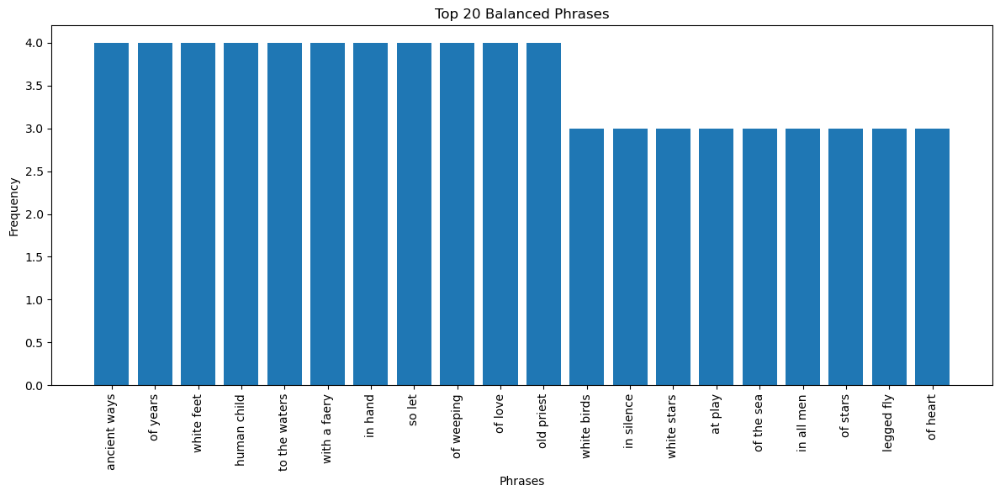

Results saved to balanced_poetic_phrases.csv


In [4]:
import json
import spacy
from collections import Counter
import pandas as pd
import matplotlib.pyplot as plt
from spacy.matcher import Matcher

# Load the English language model
nlp = spacy.load("en_core_web_md")

def extract_balanced_phrases(doc):
    matcher = Matcher(nlp.vocab)
    
    # Pattern for Adjective + Noun
    matcher.add("ADJ_NOUN", [[{"POS": "ADJ"}, {"POS": "NOUN"}]])
    
    # Pattern for Verb + (Adjective) + Noun
    matcher.add("VERB_OBJ", [[{"POS": "VERB"}, {"POS": "ADJ", "OP": "?"}, {"POS": "NOUN"}]])
    
    # Pattern for Adverb + Verb
    matcher.add("ADV_VERB", [[{"POS": "ADV"}, {"POS": "VERB"}]])
    
    # Pattern for Preposition + Noun
    matcher.add("PREP_NOUN", [[{"POS": "ADP"}, {"POS": "DET", "OP": "?"}, {"POS": "ADJ", "OP": "?"}, {"POS": "NOUN"}]])

    matches = matcher(doc)
    
    phrases = []
    for match_id, start, end in matches:
        span = doc[start:end]
        if 2 <= len(span.text.split()) <= 4:  # Ensure phrase length is between 2 and 4 words
            phrases.append(span.text.lower())
    
    return phrases

def process_poems(json_data):
    all_phrases = []
    
    for poem in json_data['poems']:
        doc = nlp(poem['content'])
        phrases = extract_balanced_phrases(doc)
        all_phrases.extend(phrases)
    
    return Counter(all_phrases)

# Load JSON data
with open("yeats-poems-dancerealted.json", 'r', encoding='utf-8') as f:
    data = json.load(f)

# Process poems
phrase_counter = process_poems(data)

# Convert to DataFrame
df = pd.DataFrame(phrase_counter.items(), columns=['Phrase', 'Frequency'])
df = df.sort_values('Frequency', ascending=False).reset_index(drop=True)

# Display top 20 phrases
print(df.head(20))

# Plot top 20 phrases
plt.figure(figsize=(12, 6))
plt.bar(df['Phrase'][:20], df['Frequency'][:20])
plt.xticks(rotation=90)
plt.title("Top 20 Balanced Phrases")
plt.xlabel("Phrases")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

# Export to CSV
df.to_csv("balanced_poetic_phrases.csv", index=False)
print("Results saved to balanced_poetic_phrases.csv")

       Combination  Frequency
0        near_come          9
1    leave_flutter          6
2         have_day          5
3       old_priest          4
4       wild_water          4
5      human_child          4
6       white_foot          4
7      ancient_way          4
8     know_phoenix          4
9           so_let          4
10      away_drive          3
11      white_bird          3
12       young_man          3
13     name_friend          3
14      legged_fly          3
15      white_star          3
16   strange_thing          3
17  little_childer          3
18         away_go          3
19    common_thing          3


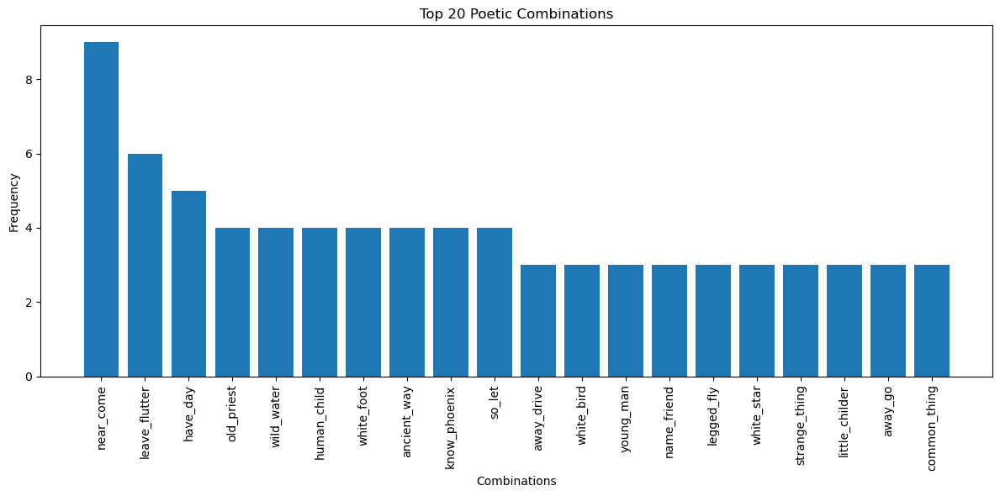

Results saved to poetic_combinations.csv


In [2]:
import json
import csv
import spacy
from collections import Counter
import pandas as pd
import matplotlib.pyplot as plt

# Load the English language model
nlp = spacy.load("en_core_web_md")

def extract_poetic_combinations(doc):
    combinations = []
    for token in doc:
        if token.pos_ in ["VERB", "NOUN", "ADJ", "ADV"]:
            # Verb + Noun
            if token.pos_ == "VERB":
                for child in token.children:
                    if child.dep_ == "dobj" and child.pos_ == "NOUN":
                        combinations.append(f"{token.lemma_}_{child.lemma_}")
            
            # Adjective + Noun
            if token.pos_ == "ADJ":
                if token.head.pos_ == "NOUN":
                    combinations.append(f"{token.lemma_}_{token.head.lemma_}")
            
            # Adverb + Verb
            if token.pos_ == "ADV":
                if token.head.pos_ == "VERB":
                    combinations.append(f"{token.lemma_}_{token.head.lemma_}")
    
    return combinations

def process_poems(json_data):
    all_combinations = []
    
    for poem in json_data['poems']:
        doc = nlp(poem['content'])
        combinations = extract_poetic_combinations(doc)
        all_combinations.extend(combinations)
    
    return Counter(all_combinations)

# Load JSON data
with open("yeats-poems-dancerealted.json", 'r', encoding='utf-8') as f:
    data = json.load(f)

# Process poems
combination_counter = process_poems(data)

# Convert to DataFrame
df = pd.DataFrame(combination_counter.items(), columns=['Combination', 'Frequency'])
df = df.sort_values('Frequency', ascending=False).reset_index(drop=True)

# Display top 20 combinations
print(df.head(20))

# Plot top 20 combinations
plt.figure(figsize=(12, 6))
plt.bar(df['Combination'][:20], df['Frequency'][:20])
plt.xticks(rotation=90)
plt.title("Top 20 Poetic Combinations")
plt.xlabel("Combinations")
plt.ylabel("Frequency")
plt.tight_layout()
plt.show()

# Export to CSV
df.to_csv("poetic_combinations.csv", index=False)
print("Results saved to poetic_combinations.csv")

Extracted dance terms: ['run', 'heavy', 'turn', 'finger', 'move', 'bee', 'man', 'faerie', 'think', 'toss', 'hurry', 'more', 'swan', 'creel', 'chase', 'tune', 'movement', 'stand', 'footstep', 'cannon', 'truth', 'dreary', 'undo', 'see', 'whirl', 'purr', 'unloved', 'leap', 'hope', 'hand', 'glow', 'fitful', 'wildere', 'outdance', 'fire', 'life', 'instep', 'music', 'melody', 'wary', 'seem', 'gather', 'beat', 'dart', 'tread', 'turning', 'return', 'golden', 'step', 'band', 'head', 'toil', 'slide', 'dance', 'one', 'chinese', 'sway', 'go', 'glide', 'tongue', 'daughter', 'wizard', 'wandering', 'grasshopper', 'shake', 'mind', 'loud', 'full', 'rage', 'image', 'spinning', 'turnin', 'silver', 'crown', 'dancer', 'song', 'peahen', 'shy', 'mirthful', 'slow', 'sing', 'pulse', 'sweet', 'priest', 'shade', 'year', 'high', 'thing', 'dream', 'brood', 'land', 'cracked', 'eyeball', 'die', 'hear', 'druid', 'parrot', 'dancing', 'fix', 'round', 'mortal', 'olden', 'whirling', 'leafy', 'right', 'hold']
            

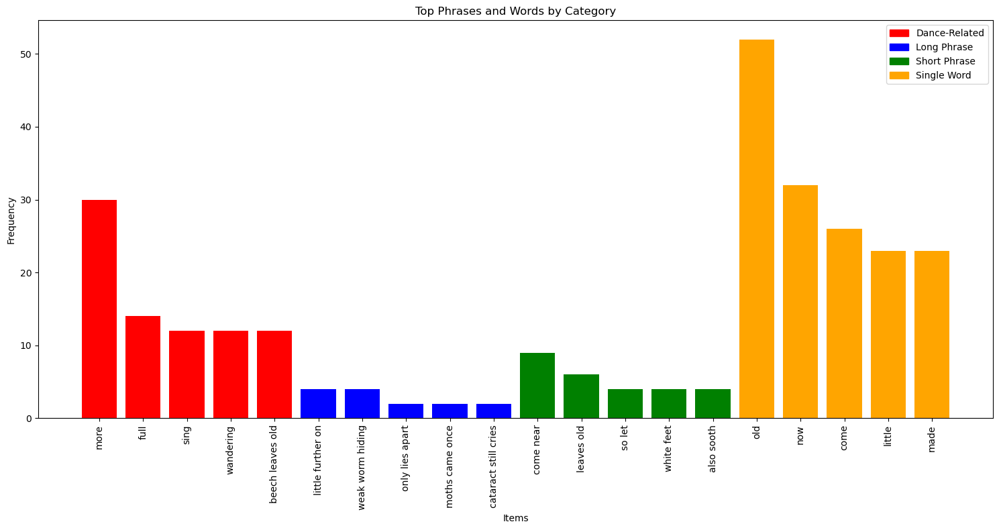

Results saved to comprehensive_poetic_analysis.csv


In [6]:
import json
import spacy
from collections import Counter
import pandas as pd
import matplotlib.pyplot as plt
from spacy.matcher import Matcher, PhraseMatcher

# Load the English language model
nlp = spacy.load("en_core_web_md")

# Define a broader list of dance-related roots and terms
dance_roots = ['danc', 'choreograph', 'ballet', 'waltz', 'tango', 'jig', 'reel', 'twirl', 'spin', 'leap', 'pirouette', 'sway', 'rhythm']
movement_terms = ['move', 'step', 'turn', 'glide', 'slide', 'jump', 'hop', 'skip', 'whirl']
music_terms = ['music', 'song', 'melody', 'tune', 'rhythm', 'beat', 'tempo']

def extract_dance_terms(json_data):
    dance_terms = set()
    phrase_matcher = PhraseMatcher(nlp.vocab)
    
    # Add patterns for multi-word terms
    patterns = [nlp(term) for term in ['dance floor', 'dance hall', 'dance music', 'dance performance']]
    phrase_matcher.add("DANCE_PHRASES", patterns)
    
    for poem in json_data['poems']:
        doc = nlp(poem['content'].lower())
        
        # Check for dance roots and related terms
        for token in doc:
            if any(root in token.lemma_ for root in dance_roots) or \
               any(term in token.lemma_ for term in movement_terms + music_terms):
                dance_terms.add(token.lemma_)
                # Add surrounding words to capture related terms
                for child in token.children:
                    if child.pos_ in ["ADJ", "NOUN", "VERB"]:
                        dance_terms.add(child.lemma_)
        
        # Check for multi-word dance terms
        matches = phrase_matcher(doc)
        for match_id, start, end in matches:
            span = doc[start:end]
            dance_terms.add(span.text)
    
    return list(dance_terms)

def extract_phrases_and_words(doc, dance_terms):
    matcher = Matcher(nlp.vocab)
    
    # Pattern for longer phrases (3-6 words)
    matcher.add("LONG_PHRASE", [[{"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}}, 
                                 {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}}, 
                                 {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}},
                                 {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}, "OP": "?"},
                                 {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}, "OP": "?"},
                                 {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}, "OP": "?"}]])
    
    # Pattern for shorter phrases (2-3 words)
    matcher.add("SHORT_PHRASE", [[{"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}}, 
                                  {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}},
                                  {"POS": {"IN": ["ADJ", "NOUN", "VERB", "ADV"]}, "OP": "?"}]])

    matches = matcher(doc)
    
    phrases_and_words = []
    for match_id, start, end in matches:
        span = doc[start:end]
        phrases_and_words.append(span.text.lower())
    
    # Add individual emotional words (verbs, adjectives, adverbs)
    for token in doc:
        if token.pos_ in ["VERB", "ADJ", "ADV"] and token.is_alpha and len(token.text) > 2:
            phrases_and_words.append(token.text.lower())
    
    return phrases_and_words

def process_poems(json_data, dance_terms):
    all_items = []
    
    for poem in json_data['poems']:
        doc = nlp(poem['content'])
        items = extract_phrases_and_words(doc, dance_terms)
        all_items.extend(items)
    
    return Counter(all_items)

# Load JSON data
with open("yeats-poems-dancerealted.json", 'r', encoding='utf-8') as f:
    data = json.load(f)

# Extract dance terms from the data
dance_terms = extract_dance_terms(data)
print("Extracted dance terms:", dance_terms)

# Process poems
item_counter = process_poems(data, dance_terms)

# Convert to DataFrame
df = pd.DataFrame(item_counter.items(), columns=['Item', 'Frequency'])
df = df.sort_values('Frequency', ascending=False).reset_index(drop=True)

# Categorize items
def categorize_item(item, dance_terms):
    if any(term in item for term in dance_terms):
        return 'Dance-Related'
    elif len(item.split()) > 2:
        return 'Long Phrase'
    elif len(item.split()) == 2:
        return 'Short Phrase'
    else:
        return 'Single Word'

df['Category'] = df['Item'].apply(lambda x: categorize_item(x, dance_terms))

# Display top items from each category
categories = ['Dance-Related', 'Long Phrase', 'Short Phrase', 'Single Word']
top_items = pd.concat([df[df['Category'] == cat].head(5) for cat in categories])
print(top_items)

# Plot top items
plt.figure(figsize=(15, 8))
colors = {'Dance-Related': 'red', 'Long Phrase': 'blue', 'Short Phrase': 'green', 'Single Word': 'orange'}
bars = plt.bar(top_items['Item'], top_items['Frequency'], color=top_items['Category'].map(colors))
plt.xticks(rotation=90)
plt.title("Top Phrases and Words by Category")
plt.xlabel("Items")
plt.ylabel("Frequency")
plt.legend(handles=[plt.Rectangle((0,0),1,1, color=colors[cat]) for cat in categories], labels=categories)
plt.tight_layout()
plt.show()

# Export to CSV
df.to_csv("comprehensive_poetic_analysis.csv", index=False)
print("Results saved to comprehensive_poetic_analysis.csv")

Top items:
      Frequency                Text       Category
745           1              But O!   Short_Phrase
1281          1  "Mavrone, mavrone!   Short_Phrase
1297          1     you come again!   Short_Phrase
45            6       leave flutter      Verb_Noun
65            5            have day      Verb_Noun
91            4        know phoenix      Verb_Noun
116           3          have peace      Verb_Noun
118           3         name friend      Verb_Noun
75            4          white foot       Adj_Noun
76            4          wild water       Adj_Noun
78            4         human child       Adj_Noun
98            4          old priest       Adj_Noun
102           4         ancient way       Adj_Noun
24            9           near come       Adv_Verb
89            4              so let       Adv_Verb
132           3             away go       Adv_Verb
161           3           away come       Adv_Verb
162           3          away drive       Adv_Verb
243           2     

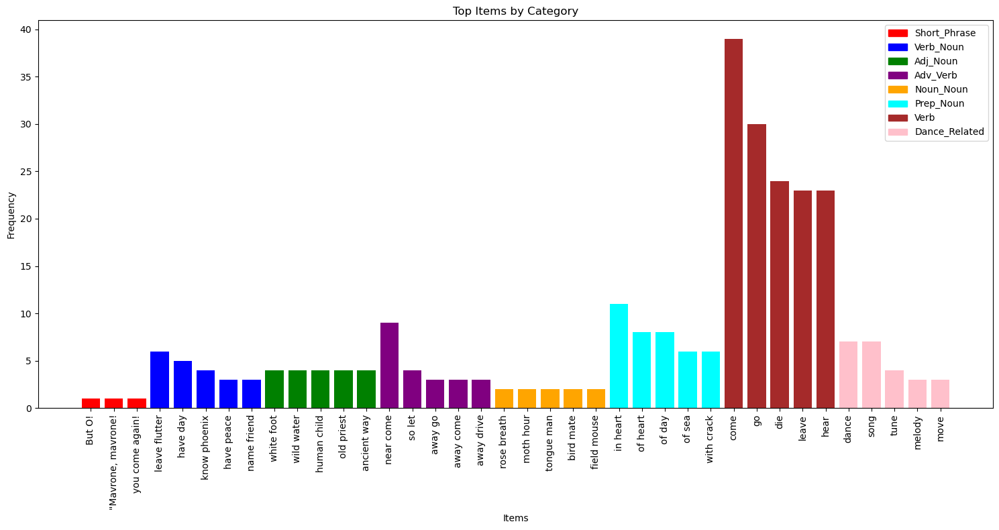

Results saved to yeats_style_items.csv and yeats_full_lines.csv


In [13]:
import json
import spacy
from collections import Counter
import pandas as pd
import matplotlib.pyplot as plt

# Load the English language model
nlp = spacy.load("en_core_web_md")

# Define dance-related terms
dance_terms = set(['dance', 'choreograph', 'ballet', 'waltz', 'tango', 'jig', 'reel', 'twirl', 'spin', 'leap', 'pirouette', 'sway', 'rhythm',
                   'move', 'step', 'turn', 'glide', 'slide', 'jump', 'hop', 'skip', 'whirl',
                   'music', 'song', 'melody', 'tune', 'beat', 'tempo'])

def extract_items(doc):
    items = []
    for sent in doc.sents:
        # Extract short phrases (3-5 words)
        if 3 <= len(sent) <= 5:
            items.append((sent.text, "Short_Phrase"))
        
        for token in sent:
            if token.pos_ in ["VERB", "NOUN", "ADJ", "ADV", "ADP"]:
                # Verb + Noun
                if token.pos_ == "VERB":
                    for child in token.children:
                        if child.dep_ == "dobj" and child.pos_ == "NOUN":
                            items.append((f"{token.lemma_} {child.lemma_}", "Verb_Noun"))
                
                # Adjective + Noun
                if token.pos_ == "ADJ":
                    if token.head.pos_ == "NOUN":
                        items.append((f"{token.lemma_} {token.head.lemma_}", "Adj_Noun"))
                
                # Adverb + Verb
                if token.pos_ == "ADV":
                    if token.head.pos_ == "VERB":
                        items.append((f"{token.lemma_} {token.head.lemma_}", "Adv_Verb"))
                
                # Noun + Noun (compound nouns)
                if token.pos_ == "NOUN":
                    for child in token.children:
                        if child.dep_ == "compound" and child.pos_ == "NOUN":
                            items.append((f"{child.lemma_} {token.lemma_}", "Noun_Noun"))
                
                # Preposition + Noun
                if token.pos_ == "ADP":
                    for child in token.children:
                        if child.pos_ == "NOUN":
                            items.append((f"{token.lemma_} {child.lemma_}", "Prep_Noun"))
                
                # Important verbs and dance-related words
                if token.pos_ == "VERB" and token.is_stop == False:
                    items.append((token.lemma_, "Verb"))
                elif token.lemma_ in dance_terms:
                    items.append((token.lemma_, "Dance_Related"))
    
    return items

def process_poems(json_data):
    all_items = []
    all_lines = []
    
    for poem in json_data['poems']:
        doc = nlp(poem['content'])
        items = extract_items(doc)
        all_items.extend(items)
        
        # Extract full lines
        lines = [sent.text.strip() for sent in doc.sents]
        all_lines.extend(lines)
    
    return Counter(all_items), Counter(all_lines)

# Load JSON data
with open("yeats-poems-dancerealted.json", 'r', encoding='utf-8') as f:
    data = json.load(f)

# Process poems
item_counter, line_counter = process_poems(data)

# Convert items to DataFrame
df_items = pd.DataFrame(item_counter.items(), columns=['Item', 'Frequency'])
df_items[['Text', 'Category']] = pd.DataFrame(df_items['Item'].tolist(), index=df_items.index)
df_items = df_items.drop('Item', axis=1)
df_items = df_items.sort_values('Frequency', ascending=False).reset_index(drop=True)

# Convert lines to DataFrame
df_lines = pd.DataFrame(line_counter.items(), columns=['Line', 'Frequency'])
df_lines = df_lines.sort_values('Frequency', ascending=False).reset_index(drop=True)

# Display top items from each category
categories = ['Short_Phrase', 'Verb_Noun', 'Adj_Noun', 'Adv_Verb', 'Noun_Noun', 'Prep_Noun', 'Verb', 'Dance_Related']
top_items = pd.concat([df_items[df_items['Category'] == cat].head(5) for cat in categories])
print("Top items:")
print(top_items)

# Display top lines
print("\nTop lines:")
print(df_lines.head(10))

# Plot top items
plt.figure(figsize=(15, 8))
colors = {'Short_Phrase': 'red', 'Verb_Noun': 'blue', 'Adj_Noun': 'green', 'Adv_Verb': 'purple', 
          'Noun_Noun': 'orange', 'Prep_Noun': 'cyan', 'Verb': 'brown', 'Dance_Related': 'pink'}
bars = plt.bar(top_items['Text'], top_items['Frequency'], color=top_items['Category'].map(colors))
plt.xticks(rotation=90)
plt.title("Top Items by Category")
plt.xlabel("Items")
plt.ylabel("Frequency")
plt.legend(handles=[plt.Rectangle((0,0),1,1, color=colors[cat]) for cat in categories], labels=categories)
plt.tight_layout()
plt.show()

# Export to CSV
df_items.to_csv("yeats_style_items.csv", index=False)
df_lines.to_csv("yeats_full_lines.csv", index=False)
print("Results saved to yeats_style_items.csv and yeats_full_lines.csv")

### 理解TSNE和PCA区别

In [7]:
import json
import plotly.graph_objects as go
from sklearn.neighbors import NearestNeighbors

# 读取PCA结果
with open('word_bag.json', 'r') as f:
    pca_data = json.load(f)

# 读取t-SNE结果
with open('word_bag_tsne.json', 'r') as f:
    tsne_data = json.load(f)

# 限制可视化的词汇数量
max_words = 100

# 提取PCA坐标和词汇
pca_coords = [[coord['x'], coord['y'], coord['z']] for coord in list(pca_data.values())[:max_words]]
pca_words = list(pca_data.keys())[:max_words]

# 提取t-SNE坐标和词汇
tsne_coords = [[coord['x'], coord['y'], coord['z']] for coord in list(tsne_data.values())[:max_words]]
tsne_words = list(tsne_data.keys())[:max_words]

# 计算PCA的邻居关系
pca_nbrs = NearestNeighbors(n_neighbors=3, algorithm='ball_tree').fit(pca_coords)
pca_distances, pca_indices = pca_nbrs.kneighbors(pca_coords)

# 计算t-SNE的邻居关系
tsne_nbrs = NearestNeighbors(n_neighbors=3, algorithm='ball_tree').fit(tsne_coords)
tsne_distances, tsne_indices = tsne_nbrs.kneighbors(tsne_coords)

# 创建PCA的3D散点图和邻居连线
pca_trace = go.Scatter3d(
    x=[coord[0] for coord in pca_coords],
    y=[coord[1] for coord in pca_coords],
    z=[coord[2] for coord in pca_coords],
    mode='markers+text',
    marker=dict(size=5, color='blue', opacity=0.8),
    text=pca_words,
    name='PCA'
)

pca_edges = []
for i in range(len(pca_coords)):
    for j in pca_indices[i][1:]:
        pca_edges.append(go.Scatter3d(
            x=[pca_coords[i][0], pca_coords[j][0]],
            y=[pca_coords[i][1], pca_coords[j][1]],
            z=[pca_coords[i][2], pca_coords[j][2]],
            mode='lines',
            line=dict(color='lightblue', width=1),
            showlegend=False
        ))

# 创建t-SNE的3D散点图和邻居连线
tsne_trace = go.Scatter3d(
    x=[coord[0] for coord in tsne_coords],
    y=[coord[1] for coord in tsne_coords],
    z=[coord[2] for coord in tsne_coords],
    mode='markers+text',
    marker=dict(size=5, color='red', opacity=0.8),
    text=tsne_words,
    name='t-SNE'
)

tsne_edges = []
for i in range(len(tsne_coords)):
    for j in tsne_indices[i][1:]:
        tsne_edges.append(go.Scatter3d(
            x=[tsne_coords[i][0], tsne_coords[j][0]],
            y=[tsne_coords[i][1], tsne_coords[j][1]],
            z=[tsne_coords[i][2], tsne_coords[j][2]],
            mode='lines',
            line=dict(color='pink', width=1),
            showlegend=False
        ))

# 创建布局
layout = go.Layout(
    title=f'PCA vs t-SNE: 3D Visualization with Neighbors (Top {max_words} Words)',
    scene=dict(
        xaxis=dict(title='X'),
        yaxis=dict(title='Y'),
        zaxis=dict(title='Z')
    )
)

# 创建图形对象
fig = go.Figure(data=[pca_trace, *pca_edges, tsne_trace, *tsne_edges], layout=layout)

# 显示图形
fig.show()

### 词向量可视化需要文件
Google Embedding Projector：     
需要2份tsv文件：1份点坐标 1份点名称  
TouchDesigner安装Python pip lib包：https://olib.amb-service.net/component/td-pip  

To just install a package run
 
op('td_pip').InstallPackage( package_name )
 
To check if a package is installed run
op("td_pip").TestModule("TestModule")

To force an upgrade on a Package run
op("td_pip").UpgradePackage( "TestModule" )


In [12]:
import pandas as pd
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.manifold import TSNE
import numpy as np

# 读取CSV文件
phrases_df = pd.read_csv('balanced_poetic_phrases.csv')
items_df = pd.read_csv('comprehensive_poetic_analysis.csv')

# 提取所需的列
phrases = phrases_df['Phrase']
items = items_df['Item']

# 合并数据
all_text = pd.concat([phrases, items])

# 创建TF-IDF向量
vectorizer = TfidfVectorizer()
tfidf_matrix = vectorizer.fit_transform(all_text)

# 转换为密集矩阵
dense_matrix = tfidf_matrix.toarray()

# 应用t-SNE降至3维
tsne = TSNE(n_components=3, random_state=42, init='random')
tsne_results = tsne.fit_transform(dense_matrix)

# 创建向量数据的TSV文件
with open('vectors.tsv', 'w', encoding='utf-8') as f:
    for vector in tsne_results:
        f.write('\t'.join(map(str, vector)) + '\n')

# 创建元数据的TSV文件（不包含标题行）
with open('metadata.tsv', 'w', encoding='utf-8') as f:
    for text in all_text:
        f.write(text + '\n')

print("处理完成。")
print("向量数据已保存到 vectors.tsv")
print("元数据已保存到 metadata.tsv")

处理完成。
向量数据已保存到 vectors.tsv
元数据已保存到 metadata.tsv


### 连环诗


In [ ]:
# Cell 1: 导入必要的库
import torch
from torch.utils.data import Dataset, DataLoader
from PIL import Image
import json
import requests
from io import BytesIO
import os
from transformers import BlipProcessor, BlipForConditionalGeneration
from tqdm import tqdm
import concurrent.futures

# 设置设备
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

In [ ]:
print("Hello, World!")

In [ ]:
# Cell 1: 基本导入
print("Importing basic libraries...")
import os
import json
import requests
from io import BytesIO
from PIL import Image
print("Basic libraries imported.")



In [ ]:
# Cell 2: 并发库导入
print("Importing concurrent futures...")
import concurrent.futures
print("Concurrent futures imported.")

# Cell 3: tqdm 导入
print("Importing tqdm...")
from tqdm import tqdm
print("tqdm imported.")

# Cell 4: PyTorch 导入
print("Importing PyTorch...")
import torch
from torch.utils.data import Dataset, DataLoader
print("PyTorch imported.")

# Cell 5: Transformers 导入
print("Importing Transformers...")
from transformers import BlipProcessor, BlipForConditionalGeneration
print("Transformers imported.")

# Cell 6: 设置设备
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(f"Using device: {device}")

# 后续 cells 保持不变...

In [ ]:
# Cell 2: 定义辅助函数
def download_image(item):
    image_url = item['image']
    image_name = os.path.basename(image_url)
    local_path = os.path.join('downloaded_images', image_name)
    
    if not os.path.exists(local_path):
        try:
            response = requests.get(image_url)
            response.raise_for_status()
            with open(local_path, 'wb') as f:
                f.write(response.content)
            return local_path
        except Exception as e:
            print(f"Error downloading {image_url}: {e}")
            return None
    return local_path

def predownload_images(json_file):
    with open(json_file, 'r') as f:
        data = json.load(f)
    
    os.makedirs('downloaded_images', exist_ok=True)
    
    with concurrent.futures.ThreadPoolExecutor(max_workers=10) as executor:
        futures = [executor.submit(download_image, item) for item in data]
        for future in tqdm(concurrent.futures.as_completed(futures), total=len(data), desc="Downloading images"):
            pass

# Cell 3: 定义数据集类
class PoleDanceDataset(Dataset):
    def __init__(self, json_file, processor):
        with open(json_file, 'r') as f:
            self.data = json.load(f)
        self.processor = processor

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        item = self.data[idx]
        image_url = item['image']
        image_name = os.path.basename(image_url)
        local_path = os.path.join('downloaded_images', image_name)
        caption = item['caption']

        image = Image.open(local_path).convert('RGB')

        inputs = self.processor(images=image, text=caption, return_tensors="pt", padding="max_length", max_length=32, truncation=True)
        inputs = {k: v.squeeze(0) for k, v in inputs.items()}

        return inputs

In [ ]:
# Cell 4: 预下载图片
json_file = 'pole-dance-gestrure-name-data.json'
print("Pre-downloading images...")
predownload_images(json_file)
print("Image download completed.")

# Cell 5: 加载模型和处理器
print("Loading model and processor...")
processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base")
model.to(device)
print("Model and processor loaded.")

# Cell 6: 创建数据集和数据加载器
print("Creating dataset and dataloader...")
dataset = PoleDanceDataset(json_file, processor)
dataloader = DataLoader(dataset, batch_size=16, shuffle=True, num_workers=4)
print(f"Dataset size: {len(dataset)}")

In [ ]:

# Cell 7: 训练循环
optimizer = torch.optim.AdamW(model.parameters(), lr=5e-5)

num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    total_loss = 0
    progress_bar = tqdm(dataloader, desc=f"Epoch {epoch+1}/{num_epochs}")
    for batch in progress_bar:
        input_ids = batch['input_ids'].to(device)
        pixel_values = batch['pixel_values'].to(device)
        attention_mask = batch['attention_mask'].to(device)
        
        outputs = model(input_ids=input_ids, 
                        pixel_values=pixel_values, 
                        attention_mask=attention_mask,
                        labels=input_ids)
        
        loss = outputs.loss
        total_loss += loss.item()

        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

        progress_bar.set_postfix({'loss': loss.item()})
    
    avg_loss = total_loss / len(dataloader)
    print(f"Epoch {epoch+1}/{num_epochs}, Average Loss: {avg_loss:.4f}")

# Cell 8: 保存微调后的模型
print("Saving fine-tuned model...")
model.save_pretrained("finetuned_blip_pole_dance")
print("Model saved.")

In [ ]:
# Cell 9: 测试模型
print("Testing model...")
model.eval()
test_image_path = os.path.join('downloaded_images', 'speedbump.jpg')
test_image = Image.open(test_image_path).convert('RGB')
inputs = processor(images=test_image, return_tensors="pt").to(device)

with torch.no_grad():
    generated_ids = model.generate(**inputs, max_length=20)
    generated_caption = processor.decode(generated_ids[0], skip_special_tokens=True)
    print("Generated caption:", generated_caption)

print("Test completed.")

### 降维策略：TSNE<=>Mocap data   
Example:     

Stanza 1:
unremembering night weary night round knee round moon
match year match cypress round
then sing finish finish dance
rule car battle car sing peace alway sing flow

Stanza 2:
woven silence gentle silence dread crying dread subtle guile
pearly heart wandering heart through heart strew stretch
weave dance olden dance try dance
sing way then sing sing nigh finish dance weave dance

Stanza 3:
leave space thrust leave now drink
therefore wander troubled mirror true brother secret spirit rent heart
austere way about telling about table play
weave dance dance dance rule car battle car

Stanza 4:
own tale own pigeon come nurture music flow
unhuman misery smite desolate heaven
about page little way austere way
dance rule car battle car sing peace alway sing

In [24]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go
from scipy.spatial.distance import cdist
import spacy
import json

# Load spaCy model
nlp = spacy.load('en_core_web_md')

# Load the word bag data
df = pd.read_csv('yeats_style_items.csv')

# Function to get word vector
def get_word_vector(word):
    return nlp(word).vector

# Get word vectors for all words
df['vector'] = df['Text'].apply(get_word_vector)

# Sort by frequency and select top 800 words
top_words = df.sort_values('Frequency', ascending=False).head(800)

# Extract vectors for top words
word_vectors = np.array(top_words['vector'].tolist())

# Perform t-SNE
tsne = TSNE(n_components=3, random_state=42)
words_3d = tsne.fit_transform(word_vectors)

# Load motion capture data
with open('full_data.json', 'r') as f:
    motion_data = json.load(f)

# Extract bone positions for each of the four points
bone_names = ['Skeleton_RToeEnd', 'Skeleton_LToeEnd', 'Skeleton_RIndex3End', 'Skeleton_LIndex3End']
bone_positions = {bone: [] for bone in bone_names}

for frame in motion_data:
    for bone in bone_names:
        bone_positions[bone].append(frame['bones'][bone])

# Convert to numpy arrays
for bone in bone_names:
    bone_positions[bone] = np.array(bone_positions[bone])

# Normalize bone positions to match the scale of t-SNE output
for bone in bone_names:
    bone_positions[bone] = (bone_positions[bone] - bone_positions[bone].min()) / (bone_positions[bone].max() - bone_positions[bone].min())
    bone_positions[bone] = bone_positions[bone] * (words_3d.max() - words_3d.min()) + words_3d.min()

# Function to get words "touched" by the motion trajectory
def get_touched_words(words, word_positions, trajectory, threshold=1):
    distances = cdist(word_positions, trajectory)
    min_distances = distances.min(axis=1)
    nearby_indices = np.where(min_distances < threshold)[0]
    return nearby_indices, [words[idx] for idx in nearby_indices]

# Get touched words for each bone
touched_words = {}
touched_indices = {}
for bone in bone_names:
    touched_indices[bone], touched_words[bone] = get_touched_words(top_words['Text'].tolist(), words_3d, bone_positions[bone])

# Print words "touched" by each trajectory
for bone in bone_names:
    print(f"\nWords 'touched' by {bone}:")
    print(touched_words[bone])

# Create the 3D plot using Plotly
fig = go.Figure()

# Plot all words
fig.add_trace(go.Scatter3d(
    x=words_3d[:, 0], y=words_3d[:, 1], z=words_3d[:, 2],
    mode='markers',
    marker=dict(size=3, color='gray', opacity=0.3),
    text=top_words['Text'],
    hoverinfo='text',
    name='All Words'
))

# Colors for different bones
colors = ['red', 'blue', 'green', 'purple']

# Plot touched words and trajectories for each bone
for bone, color in zip(bone_names, colors):
    # Touched words
    fig.add_trace(go.Scatter3d(
        x=words_3d[touched_indices[bone], 0],
        y=words_3d[touched_indices[bone], 1],
        z=words_3d[touched_indices[bone], 2],
        mode='markers+text',
        marker=dict(size=5, color=color, opacity=0.8),
        text=[top_words['Text'].iloc[i] for i in touched_indices[bone]],
        textposition="top center",
        hoverinfo='text',
        name=f'{bone} Touched Words'
    ))
    
    # Trajectory
    fig.add_trace(go.Scatter3d(
        x=bone_positions[bone][:, 0],
        y=bone_positions[bone][:, 1],
        z=bone_positions[bone][:, 2],
        mode='lines',
        line=dict(color=color, width=2),
        name=f'{bone} Trajectory'
    ))

# Update layout
fig.update_layout(
    title="Interactive 3D Visualization of Yeats' Top 800 Words and Four-Point Motion Capture Data",
    scene=dict(
        xaxis_title='t-SNE 1',
        yaxis_title='t-SNE 2',
        zaxis_title='t-SNE 3'
    ),
    legend_title="Elements",
    width=1200,
    height=800
)

# Show the plot
fig.show()

# Save results to a file
with open('touched_words_by_trajectory.json', 'w') as f:
    json.dump(touched_words, f, indent=2)

print("Results saved to 'touched_words_by_trajectory.json'")


Words 'touched' by Skeleton_RToeEnd:
['field mouse', 'chase', 'for flight', 'for head', 've', 'under board', 'among crowd', 'ago die']

Words 'touched' by Skeleton_LToeEnd:
['have day', 'care', 'between petal', 'within gloom', 'under board', 'therefore wander', 'well know']

Words 'touched' by Skeleton_RIndex3End:
['end']

Words 'touched' by Skeleton_LIndex3End:
['rose breath', 'from dreamer', 'cover world', 'from field']


Results saved to 'touched_words_by_trajectory.json'


In [49]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go
from scipy.spatial.distance import cdist
import spacy
import json
import random

# Load spaCy model
nlp = spacy.load('en_core_web_md')

# Load the word bag data
df = pd.read_csv('yeats_style_items.csv')

# Function to get word vector
def get_word_vector(word):
    return nlp(word).vector

# Get word vectors for all words
df['vector'] = df['Text'].apply(get_word_vector)

# Sort by frequency and select top 1500 words
top_words = df.sort_values('Frequency', ascending=False).head(2500)

# Extract vectors for top words
word_vectors = np.array(top_words['vector'].tolist())

# Perform t-SNE
tsne = TSNE(n_components=3, random_state=42)
words_3d = tsne.fit_transform(word_vectors)

# Load motion capture data
with open('full_data.json', 'r') as f:
    motion_data = json.load(f)

# Extract bone positions for each of the four points
bone_names = ['Skeleton_RToeEnd', 'Skeleton_LToeEnd', 'Skeleton_RIndex3End', 'Skeleton_LIndex3End']
bone_positions = {bone: [] for bone in bone_names}

for frame in motion_data:
    for bone in bone_names:
        bone_positions[bone].append(frame['bones'][bone])

# Convert to numpy arrays
for bone in bone_names:
    bone_positions[bone] = np.array(bone_positions[bone])

# Normalize bone positions to match the scale of t-SNE output
for bone in bone_names:
    bone_positions[bone] = (bone_positions[bone] - bone_positions[bone].min()) / (bone_positions[bone].max() - bone_positions[bone].min())
    bone_positions[bone] = bone_positions[bone] * (words_3d.max() - words_3d.min()) + words_3d.min()

# Function to get words "touched" by the motion trajectory
def get_touched_words(words, word_positions, trajectory, threshold=1.5):
    distances = cdist(word_positions, trajectory)
    min_distances = distances.min(axis=1)
    nearby_indices = np.where(min_distances < threshold)[0]
    return nearby_indices, [words[idx] for idx in nearby_indices]

# Get touched words for each bone
touched_words = {}
touched_indices = {}
for bone in bone_names:
    touched_indices[bone], touched_words[bone] = get_touched_words(top_words['Text'].tolist(), words_3d, bone_positions[bone])

# Function to generate a line of poetry
def generate_line(words, min_words=3, max_words=4):
    if len(words) < min_words:
        return ' '.join(words)
    line_words = random.sample(words, min(len(words), random.randint(min_words, max_words)))
    return ' '.join(line_words)


# Generate poem with multiple stanzas
poem = []
for _ in range(4):  # Generate 4 stanzas
    stanza = []
    for bone in bone_names:
        line = generate_line(touched_words[bone]) 
        stanza.append(line)
    poem.append(stanza)

# Print the poem
print("Generated Poem:")
for i, stanza in enumerate(poem):
    print(f"\nStanza {i+1}:")
    for line in stanza:  
        print(line)

# Print touched words for each bone point
for bone in bone_names:
    print(f"\n{bone} touched words:")
    for word in touched_words[bone]:
        print(word)

# Create the 3D plot using Plotly
fig = go.Figure()

# Plot all words
fig.add_trace(go.Scatter3d(
    x=words_3d[:, 0], y=words_3d[:, 1], z=words_3d[:, 2],
    mode='markers',
    marker=dict(size=2, color='lightgray', opacity=0.3),
    text=top_words['Text'],
    hoverinfo='text',
    name='All Words'
))

# Colors for different bones
colors = ['red', 'blue', 'green', 'purple']

# Plot touched words and trajectories for each bone
for bone, color in zip(bone_names, colors):
    # Touched words
    fig.add_trace(go.Scatter3d(
        x=words_3d[touched_indices[bone], 0],
        y=words_3d[touched_indices[bone], 1],
        z=words_3d[touched_indices[bone], 2],
        mode='markers+text',
        marker=dict(size=4, color=color, opacity=1),  # Increased opacity for highlighting
        text=[top_words['Text'].iloc[i] for i in touched_indices[bone]],
        textposition="top center",
        hoverinfo='text',
        name=f'{bone} Touched Words'
    ))
    
    # Trajectory
    fig.add_trace(go.Scatter3d(
        x=bone_positions[bone][:, 0],
        y=bone_positions[bone][:, 1],
        z=bone_positions[bone][:, 2],
        mode='lines',
        line=dict(color=color, width=0.5),  # Reduced width for clearer visualization
        name=f'{bone} Trajectory'
    ))

# Update layout
fig.update_layout(
    title="Interactive 3D Visualization of Yeats' Top 800 Words and Four-Point Motion Capture Data",
    scene=dict(
        xaxis_title='t-SNE 1',
        yaxis_title='t-SNE 2',
        zaxis_title='t-SNE 3',
        aspectmode='cube'  # Ensure equal aspect ratio
    ),
    legend_title="Elements",
    width=1200,
    height=800
)

# Show the plot
fig.show()

# Save results to a file
with open('touched_words_by_trajectory.json', 'w') as f:
    json.dump(touched_words, f, indent=2)

print("Results saved to 'touched_words_by_trajectory.json'")


Generated Poem:

Stanza 1:
drive tumult hear lowing down path
dabble endless reverie valley stopping
sudden word olden dance right dance dance
rove dance wither round place

Stanza 2:
ingenious thing dance always listen
sleepy ground round place glut
sing nigh play sing way sudden word
then sing sing nigh sing peace

Stanza 3:
conceive thing nurture dance life
other love round chest strew chase round
sing sudden word then sing weave dance
half write battle car sing nigh sing way

Stanza 4:
win torque brazen car secret meditation wizard thing
bean row wandering heart proclaim holiday fling
sudden word austere way gentle way
dwelt race finish dance half write round

Skeleton_RToeEnd touched words:
come
dance
lie
tell
dance
drive
sleep
begin
ancient way
fear
beat
help
own heart
ruin
imagine
mortal hope
heavy hope
labour
like child
thrust
before time
arise
brazen car
leave space
eternal beauty
grieve
certain good
nurture
after hem
draw
trouble
own sadness
toil
now wander
last come
now shak

Results saved to 'touched_words_by_trajectory.json'


In [55]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE
import plotly.graph_objects as go
from scipy.spatial.distance import cdist
import spacy
import json
import random

# Load spaCy model
nlp = spacy.load('en_core_web_md')

# Load the word bag data
df = pd.read_csv('yeats_style_items.csv')

# Function to get word vector
def get_word_vector(word):
    return nlp(word).vector

# Get word vectors for all words
df['vector'] = df['Text'].apply(get_word_vector)

# Sort by frequency and select top 2500 words
top_words = df.sort_values('Frequency', ascending=False).head(2500)

# Extract vectors for top words
word_vectors = np.array(top_words['vector'].tolist())

# Perform t-SNE
tsne = TSNE(n_components=3, random_state=42)
words_3d = tsne.fit_transform(word_vectors)

# Load motion capture data
with open('full_data.json', 'r') as f:
    motion_data = json.load(f)

# Extract bone positions for each of the four points
bone_names = ['Skeleton_RToeEnd', 'Skeleton_LToeEnd', 'Skeleton_RIndex3End', 'Skeleton_LIndex3End']
bone_positions = {bone: [] for bone in bone_names}

for frame in motion_data:
    for bone in bone_names:
        bone_positions[bone].append(frame['bones'][bone])

# Convert to numpy arrays
for bone in bone_names:
    bone_positions[bone] = np.array(bone_positions[bone])

# Normalize bone positions to match the scale of t-SNE output
for bone in bone_names:
    bone_positions[bone] = (bone_positions[bone] - bone_positions[bone].min()) / (bone_positions[bone].max() - bone_positions[bone].min())
    bone_positions[bone] = bone_positions[bone] * (words_3d.max() - words_3d.min()) + words_3d.min()

# Function to get word sequence based on trajectory
def get_word_sequence(words, word_positions, trajectory, threshold=1.5):
    distances = cdist(word_positions, trajectory)
    min_distances = distances.min(axis=1)
    touched_indices = np.where(min_distances < threshold)[0]
    
    # Sort touched indices based on when they were first touched
    first_touch_frame = distances[touched_indices].argmin(axis=1)
    sorted_indices = touched_indices[np.argsort(first_touch_frame)]
    
    return [words[idx] for idx in sorted_indices]

# Generate sequences for each bone
word_sequences = {}
for bone in bone_names:
    word_sequences[bone] = get_word_sequence(top_words['Text'].tolist(), words_3d, bone_positions[bone])

# Print the sequences
for bone in bone_names:
    print(f"\n{bone} word sequence:")
    print(" ".join(word_sequences[bone]))

# Function to generate a line of poetry
def generate_line(words, min_words=3, max_words=5):
    if len(words) < min_words:
        return ' '.join(words)
    start = random.randint(0, max(0, len(words) - max_words))
    line_words = words[start:start + random.randint(min_words, max_words)]
    return ' '.join(line_words)

# Generate poem with multiple stanzas
poem = []
for _ in range(4):  # Generate 4 stanzas
    stanza = []
    for bone in bone_names:
        line = generate_line(word_sequences[bone])
        stanza.append(line)
    poem.append(stanza)

# Print the poem
print("\nGenerated Poem:")
for i, stanza in enumerate(poem):
    print(f"\nStanza {i+1}:")
    for line in stanza:
        print(line)

# Create the 3D plot using Plotly
fig = go.Figure()

# Plot all words
fig.add_trace(go.Scatter3d(
    x=words_3d[:, 0], y=words_3d[:, 1], z=words_3d[:, 2],
    mode='markers',
    marker=dict(size=2, color='lightgray', opacity=0.3),
    text=top_words['Text'],
    hoverinfo='text',
    name='All Words'
))

# Colors for different bones
colors = ['red', 'blue', 'green', 'purple']

# Plot touched words and trajectories for each bone
for bone, color in zip(bone_names, colors):
    # Touched words
    touched_indices = [top_words['Text'].tolist().index(word) for word in word_sequences[bone]]
    fig.add_trace(go.Scatter3d(
        x=words_3d[touched_indices, 0],
        y=words_3d[touched_indices, 1],
        z=words_3d[touched_indices, 2],
        mode='markers+text',
        marker=dict(size=4, color=color, opacity=1),
        text=[top_words['Text'].iloc[i] for i in touched_indices],
        textposition="top center",
        hoverinfo='text',
        name=f'{bone} Touched Words'
    ))
    
    # Trajectory
    fig.add_trace(go.Scatter3d(
        x=bone_positions[bone][:, 0],
        y=bone_positions[bone][:, 1],
        z=bone_positions[bone][:, 2],
        mode='lines',
        line=dict(color=color, width=0.5),
        name=f'{bone} Trajectory'
    ))

# Update layout
fig.update_layout(
    title="Interactive 3D Visualization of Yeats' Top 2500 Words and Four-Point Motion Capture Data",
    scene=dict(
        xaxis_title='t-SNE 1',
        yaxis_title='t-SNE 2',
        zaxis_title='t-SNE 3',
        aspectmode='cube'
    ),
    legend_title="Elements",
    width=1200,
    height=800
)

# Show the plot
fig.show()

# Save results to a file
with open('word_sequences_by_trajectory.json', 'w') as f:
    json.dump(word_sequences, f, indent=2)

print("Results saved to 'word_sequences_by_trajectory.json'")


Skeleton_RToeEnd word sequence:
after hem after thunder after tumult before time scented press woven silence gentle silence dread crying dread subtle guile melodious guile toil eternal beauty body perfection unremembering night weary night round knee round moon drive swine now drop now lay lie tell ever wander journey rule car battle car brazen car fast hold slowly hold hold dream draw read story young law indifferent law half write bear body drive mood drive tumult thrust only lie hear lowing always listen dwelt race gentle race lap win torque beat drive now drive now ride now gape now lie lie eternity apart lie sad tell naught hear cry story wintry race round chest chase round round run leave chair leave space thrust leave now drink now shake now wander imagine lie imagine lotus talk ruin heavy hope afflict mankind fear a telling ancient way hush way sleep fear hurt labour dead labourer sing nigh down path furious path settle blame poor luck poor fisher good labourer good goodness c

Results saved to 'word_sequences_by_trajectory.json'


## 升维策略  
利用傅里叶转换处理动捕数据并升维到300维，并将文本数据升维到300维进行对应，生成文本

In [9]:
import json
import numpy as np
from scipy.fft import fft, ifft
from scipy.spatial.distance import cdist
import time

# 读取数据
with open('data_every_30_frames.json', 'r') as f:
    motion_data = json.load(f)

with open('yeats-poems-dancerealted.json', 'r') as f:
    corpus_data = json.load(f)

# 提取动捕数据
motion_vectors = []
for frame in motion_data:
    vector = []
    for bone, coords in frame['bones'].items():
        vector.extend(coords)
    motion_vectors.append(vector)

motion_vectors = np.array(motion_vectors)

print("Original motion vectors shape:", motion_vectors.shape)

def upsample_vector_fft(vector, target_dim):
    # 执行傅里叶变换
    fft_result = fft(vector)
    
    # 在频域中进行插值
    freq_resolution = len(fft_result) / target_dim
    upsampled_fft = np.zeros(target_dim, dtype=complex)
    
    for i in range(target_dim):
        src_index = int(i * freq_resolution)
        upsampled_fft[i] = fft_result[src_index]
    
    # 执行逆傅里叶变换
    upsampled = ifft(upsampled_fft).real
    
    # 注释掉噪声添加
    # noise = np.random.randn(target_dim) * 0.01 * np.std(upsampled)
    # return upsampled + noise
    return upsampled

motion_vectors_300d = np.array([upsample_vector_fft(v, 300) for v in motion_vectors])

print("Upsampled motion vectors shape:", motion_vectors_300d.shape)

all_words = []
for poem in corpus_data['poems']:
    words = poem['content'].split()
    all_words.extend(words)

# 使用更复杂的词向量生成方法
word_vectors = np.random.randn(len(all_words), 300)
word_vectors = word_vectors / np.linalg.norm(word_vectors, axis=1)[:, np.newaxis]

def generate_poem_with_diversity(motion_vectors, word_vectors, all_words, max_repetitions=2, cooldown=20, candidates=5):
    poem = []
    word_count = {}
    last_used = {}
    
    for i, motion_vector in enumerate(motion_vectors):
        distances = cdist([motion_vector], word_vectors, metric='cosine')[0]
        sorted_indices = np.argsort(distances)
        
        for j in range(candidates):
            index = sorted_indices[j]
            word = all_words[index]
            
            if word_count.get(word, 0) < max_repetitions and (i - last_used.get(word, -cooldown)) > cooldown:
                poem.append(word)
                word_count[word] = word_count.get(word, 0) + 1
                last_used[word] = i
                break
        else:
            # 如果没有找到合适的词，使用一个随机词
            poem.append(np.random.choice(all_words))
        
        # 每生成8个词，输出一行诗句
        if len(poem) % 8 == 0:
            print(' '.join(poem[-8:]))
            time.sleep(0.5)  # 暂停0.5秒，模拟实时效果
    
    return poem

print("生成的诗（实时输出）:")
poem = generate_poem_with_diversity(motion_vectors_300d, word_vectors, all_words)

# 导出升维后的数据为JSON
output_data = []
for i, vector in enumerate(motion_vectors_300d):
    output_data.append({
        "frame": motion_data[i]["frame"],
        "vector": vector.tolist()
    })

with open('motion_vectors_300d.json', 'w') as f:
    json.dump(output_data, f)

print("\n升维后的数据已保存到 motion_vectors_300d.json")

Original motion vectors shape: (333, 12)
Upsampled motion vectors shape: (333, 300)
生成的诗（实时输出）:
there's our leaning under truth, mind rain bear
astray; "Saileth that And on a we sun's
come the Are I my sleep? handsome Dermot
human their went our nodded astray; "Saileth that
and dweller Or And at up, But daughters,
to will side handsome my the on Were
I Dermot lips, sun's child has the they
turned her world-troubling rows a Or and their
grow the long the and had now, or
day; sing the wandering all the And the
man's world's cloven and must A earth day.
creak But Seek, grew wild.' Danaan could peahens
kind made II of a sleep silence. at
love, And knelt, hand young hounds knew came
mire, let sings, in away sake.' God God
The The creak Constrained, in warmer his straw-pale
And continual horn. the full lack And How
her leafy what for me wind mad. by,
world-troubling Are dies glow peace, And the come
mind: fate; a proud ghostly dweller my mad.
their or moon I scot-free; no did whirled,
not sh

In [24]:
import numpy as np
from scipy.fft import fft, ifft
from scipy.spatial.distance import cdist
import time

# 读取数据
with open('data_every_30_frames.json', 'r') as f:
    motion_data = json.load(f)

with open('yeats-poems-dancerealted.json', 'r') as f:
    corpus_data = json.load(f)

# 提取动捕数据
motion_vectors = []
for frame in motion_data:
    vector = []
    for bone, coords in frame['bones'].items():
        vector.extend(coords)
    motion_vectors.append(vector)

motion_vectors = np.array(motion_vectors)
print("Original motion vectors shape:", motion_vectors.shape)

def upsample_vector_fft(vector, target_dim):
    fft_result = fft(vector)
    freq_resolution = len(fft_result) / target_dim
    upsampled_fft = np.zeros(target_dim, dtype=complex)
    
    for i in range(target_dim):
        src_index = int(i * freq_resolution)
        upsampled_fft[i] = fft_result[src_index]
    
    upsampled = ifft(upsampled_fft).real
    return upsampled

motion_vectors_300d = np.array([upsample_vector_fft(v, 300) for v in motion_vectors])
print("Upsampled motion vectors shape:", motion_vectors_300d.shape)

all_words = []
for poem in corpus_data['poems']:
    words = poem['content'].split()
    all_words.extend(words)

# 使用更复杂的词向量生成方法
word_vectors = np.random.randn(len(all_words), 300)
word_vectors = word_vectors / np.linalg.norm(word_vectors, axis=1)[:, np.newaxis]

def generate_poem_with_timing_and_cooldown(motion_vectors, word_vectors, all_words, seconds_per_word=1, words_per_line=8, max_repetitions=2, cooldown=20, candidates=5):
    poem = []
    line = []
    word_count = {}
    last_used = {}
    
    for i, motion_vector in enumerate(motion_vectors):
        distances = cdist([motion_vector], word_vectors, metric='cosine')[0]
        sorted_indices = np.argsort(distances)
        
        chosen_word = None
        for j in range(candidates):
            index = sorted_indices[j]
            word = all_words[index]
            
            if word_count.get(word, 0) < max_repetitions and (i - last_used.get(word, -cooldown)) > cooldown:
                chosen_word = word
                word_count[word] = word_count.get(word, 0) + 1
                last_used[word] = i
                break
        
        if chosen_word is None:
            chosen_word = np.random.choice(all_words)
        
        line.append(chosen_word)
        poem.append(chosen_word)
        
        print(chosen_word, end='', flush=True)
        time.sleep(seconds_per_word)
        
        if len(line) % words_per_line == 0:
            print()
            line = []
        else:
            print(" ", end='', flush=True)
    
    # 打印最后一行（如果有的话）
    if line:
        print()
    
    return poem

print("\n生成的诗（实时输出，每秒一个词）:")
poem = generate_poem_with_timing_and_cooldown(motion_vectors_300d, word_vectors, all_words)

# 导出升维后的数据为JSON
output_data = []
for i, vector in enumerate(motion_vectors_300d):
    output_data.append({
        "frame": motion_data[i]["frame"],
        "vector": vector.tolist()
    })

with open('motion_vectors_300d.json', 'w') as f:
    json.dump(output_data, f)

print("\n\n升维后的数据已保存到 motion_vectors_300d.json")

Original motion vectors shape: (333, 12)
Upsampled motion vectors shape: (333, 300)

生成的诗（实时输出，每秒一个词）:
The are as were and snow-white Because to
from tossing To eyeballs Although they sometimes now
Great fruit love wild the And in as
out they with were be Cried That To
tossing with eyeballs Although night they Know, no
love drunk softly horses; sometimes of Moll in
more had wary, grass Cried That still to
Still And tide; sighs; that The the sick
Hers says could There, long-legged of nor nigh
were mingling fall heart. And birds no Although
And men. your all meteors in she evening
is kiss burn Juliet more to our his
upon One in shell, they silver won at
And Know, help a fowl chaunt will dwelt
Arise off drunk with one, pass; and all
gentle "He There melody, build white with score
How That Michael, its a and the all
evening alone a Some betray; from domino, cloud.
my a-flutter with all cage the men under
bill flowers wild round; Rose The and I
to Powers one, she made works lion of
us to my

In [54]:
import pandas as pd
import numpy as np
from scipy.spatial.distance import cdist
from scipy.fft import fft
import spacy
import json
import random

# Load spaCy model
nlp = spacy.load('en_core_web_md')

# Load the word bag data
df = pd.read_csv('yeats_style_items.csv')

# Function to get word vector
def get_word_vector(word):
    return nlp(word).vector

# Get word vectors for all words
df['vector'] = df['Text'].apply(get_word_vector)

# Sort by frequency and select top 2500 words
top_words = df.sort_values('Frequency', ascending=False).head(2500)

# Extract vectors for top words
word_vectors = np.array(top_words['vector'].tolist())

# Load motion capture data
with open('full_data.json', 'r') as f:
    motion_data = json.load(f)

# Extract bone positions for each of the four points
bone_names = ['Skeleton_RToeEnd', 'Skeleton_LToeEnd', 'Skeleton_RIndex3End', 'Skeleton_LIndex3End']
bone_positions = {bone: [] for bone in bone_names}

for frame in motion_data:
    for bone in bone_names:
        bone_positions[bone].append(frame['bones'][bone])

# Convert to numpy arrays
for bone in bone_names:
    bone_positions[bone] = np.array(bone_positions[bone])

# Function to apply Fourier Transform and expand dimensions
def fourier_transform_expand(trajectory, target_dim=300):
    # Apply FFT to each dimension
    fft_result = np.apply_along_axis(fft, 0, trajectory)
    
    # Get amplitudes
    amplitudes = np.abs(fft_result)
    
    # Pad or truncate to reach target dimension
    if amplitudes.shape[1] < target_dim:
        padded = np.pad(amplitudes, ((0, 0), (0, target_dim - amplitudes.shape[1])), mode='constant')
        return padded
    else:
        return amplitudes[:, :target_dim]

# Apply Fourier Transform and expand dimensions for each bone trajectory
high_dim_trajectories = {}
for bone in bone_names:
    high_dim_trajectories[bone] = fourier_transform_expand(bone_positions[bone])

# Normalize high-dimensional trajectories
for bone in bone_names:
    high_dim_trajectories[bone] = (high_dim_trajectories[bone] - high_dim_trajectories[bone].min()) / (high_dim_trajectories[bone].max() - high_dim_trajectories[bone].min())
    high_dim_trajectories[bone] = high_dim_trajectories[bone] * (word_vectors.max() - word_vectors.min()) + word_vectors.min()

# Function to get word sequence based on high-dimensional trajectory
def get_word_sequence(words, word_vectors, trajectory, threshold=1):
    distances = cdist(word_vectors, trajectory, metric='cosine')
    min_distances = distances.min(axis=1)
    touched_indices = np.where(min_distances < threshold)[0]
    
    # Sort touched indices based on when they were first touched
    first_touch_frame = distances[touched_indices].argmin(axis=1)
    sorted_indices = touched_indices[np.argsort(first_touch_frame)]
    
    return [words[idx] for idx in sorted_indices]

# Generate sequences for each bone
word_sequences = {}
for bone in bone_names:
    word_sequences[bone] = get_word_sequence(top_words['Text'].tolist(), word_vectors, high_dim_trajectories[bone])

# Print the sequences
for bone in bone_names:
    print(f"\n{bone} word sequence:")
    print(" ".join(word_sequences[bone]))

# Function to generate a line of poetry
def generate_line(words, min_words=3, max_words=5):
    if len(words) < min_words:
        return ' '.join(words)
    start = random.randint(0, max(0, len(words) - max_words))
    line_words = words[start:start + random.randint(min_words, max_words)]
    return ' '.join(line_words)

# Generate poem with multiple stanzas
poem = []
for _ in range(4):  # Generate 4 stanzas
    stanza = []
    for bone in bone_names:
        line = generate_line(word_sequences[bone])
        stanza.append(line)
    poem.append(stanza)

# Print the poem
print("\nGenerated Poem:")
for i, stanza in enumerate(poem):
    print(f"\nStanza {i+1}:")
    for line in stanza:
        print(line)

# Save results to a file
with open('word_sequences_by_high_dim_trajectory.json', 'w') as f:
    json.dump(word_sequences, f, indent=2)

print("Results saved to 'word_sequences_by_high_dim_trajectory.json'")


Skeleton_RToeEnd word sequence:
among rush hide horn for word catch before dawn murmur ye bind thy thy word gaze hound wane hurl know triumph echo harbouring seek word blind loosen fretful word chase make moan sudden word rock bade idle word chase bubble only breed wave hand glimmer smite only gaze blank eye finish loudly call gently lead unfold whispering word moan read whirl faint odour silence undo sweep lonely ship rub eye wail round place feebly say journey famous ivory miss troll whirl buoy with sail make world pitch open make beloved gaze chase round drip rub pass tiptoe call man depart hear reed barter exult rule car lift eyelid whimper dwelt foul storm wary footstep plashy place with footstep faery vow round moon loud song please sail level shore within gloom conceive deny spake make worm under dawn pour barbarous clangour many shore strange place nail board open door enwound web "Mavrone, mavrone! bar betide rule shadow make shower grassy road bitter tide rule wizard song mu